In [13]:
from pyspark.sql import SparkSession
from pyspark.sql.functions import col

In [14]:
# Tạo Spark Session
spark = SparkSession.builder.appName("MyApp").getOrCreate()

# Đọc dữ liệu từ tệp TSV trên Hadoop và chuyển đổi sang định dạng DataFrame của Spark
df = spark.read.csv("hdfs://localhost:9000/amazon_reviews_us_Shoes_v1_00.tsv", sep='\t', header=True)

In [15]:
# Chuyển đổi kiểu dữ liệu cột star_rating sang kiểu số nguyên
df = df.withColumn("star_rating", col("star_rating").cast("int"))

# Sắp xếp kết quả theo thứ tự tăng dần của trung bình cộng của star_rating
df = df.orderBy("star_rating", ascending=True)

# Hiển thị dữ liệu
df.select("review_headline", "review_body").show(5000, False)

+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

In [18]:
import nltk
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))

def remove_stop_words(text):
    # Tách các từ riêng lẻ trong văn bản
    tokens = nltk.word_tokenize(text)
    # Loại bỏ các từ dừng
    filtered_tokens = [word for word in tokens if word.lower() not in stop_words]
    # Ghép các từ lại thành câu
    filtered_text = ' '.join(filtered_tokens)
    return filtered_text

import spacy

def chunk(review_headline, review_body):
    nlp = spacy.load('en_core_web_sm')

    text = "Too many zippers, heavy and it had a middle zipper pocket, which I just hate.  Don't like that at all."

    # Xóa các từ dừng
    text = remove_stop_words(review_headline)
    text2 = remove_stop_words(review_body)

    # Phân tích đoạn văn bản bằng spaCy
    doc = nlp(text)
    doc2 = nlp(text2)

    # Tìm danh sách các cụm từ chính trong đoạn văn bản
    noun_chunks = list(doc.noun_chunks)
    noun_chunks_2 = list(doc2.noun_chunks)

    noun_chunks_str = ";".join([chunk.text for chunk in noun_chunks])
    noun_chunks_str_2 = ";".join([chunk.text for chunk in noun_chunks_2])

    print(noun_chunks_str)
    print(noun_chunks_str_2)
    return noun_chunks_str, noun_chunks_str_2

In [19]:
from pyspark.sql.functions import udf
from pyspark.sql.types import ArrayType, StringType

# Khai báo hàm UDF để áp dụng hàm chunk trên hai chuỗi đầu vào
chunk_udf = udf(lambda headline, body: chunk(headline, body), ArrayType(StringType()))

# Thêm hai cột mới chứa danh sách các cụm từ chính được tìm thấy
df = df.withColumn("noun_chunks", chunk_udf("review_headline", "review_body")) \
       .withColumn("noun_chunks_2", chunk_udf("review_headline", "review_body")) \
       .withColumn("noun_chunks_str", udf(lambda chunks: ";".join(chunks), StringType())("noun_chunks")) \
       .withColumn("noun_chunks_str_2", udf(lambda chunks: ";".join(chunks), StringType())("noun_chunks_2"))

# Hiển thị 5 dòng đầu tiên của bảng và các cột mới thêm vào
df.select("review_headline", "review_body", "noun_chunks_str", "noun_chunks_str_2").show(5, False)



Py4JJavaError: An error occurred while calling o417.showString.
: org.apache.spark.SparkException: Job aborted due to stage failure: Task 5 in stage 26.0 failed 1 times, most recent failure: Lost task 5.0 in stage 26.0 (TID 180) (DESKTOP-THJ4C2C executor driver): java.net.ConnectException: Call From DESKTOP-THJ4C2C/192.168.1.5 to localhost:9000 failed on connection exception: java.net.ConnectException: Connection refused: no further information; For more details see:  http://wiki.apache.org/hadoop/ConnectionRefused
	at java.base/jdk.internal.reflect.NativeConstructorAccessorImpl.newInstance0(Native Method)
	at java.base/jdk.internal.reflect.NativeConstructorAccessorImpl.newInstance(NativeConstructorAccessorImpl.java:62)
	at java.base/jdk.internal.reflect.DelegatingConstructorAccessorImpl.newInstance(DelegatingConstructorAccessorImpl.java:45)
	at java.base/java.lang.reflect.Constructor.newInstance(Constructor.java:490)
	at org.apache.hadoop.net.NetUtils.wrapWithMessage(NetUtils.java:913)
	at org.apache.hadoop.net.NetUtils.wrapException(NetUtils.java:828)
	at org.apache.hadoop.ipc.Client.getRpcResponse(Client.java:1616)
	at org.apache.hadoop.ipc.Client.call(Client.java:1558)
	at org.apache.hadoop.ipc.Client.call(Client.java:1455)
	at org.apache.hadoop.ipc.ProtobufRpcEngine2$Invoker.invoke(ProtobufRpcEngine2.java:242)
	at org.apache.hadoop.ipc.ProtobufRpcEngine2$Invoker.invoke(ProtobufRpcEngine2.java:129)
	at com.sun.proxy.$Proxy35.getBlockLocations(Unknown Source)
	at org.apache.hadoop.hdfs.protocolPB.ClientNamenodeProtocolTranslatorPB.getBlockLocations(ClientNamenodeProtocolTranslatorPB.java:333)
	at jdk.internal.reflect.GeneratedMethodAccessor79.invoke(Unknown Source)
	at java.base/jdk.internal.reflect.DelegatingMethodAccessorImpl.invoke(DelegatingMethodAccessorImpl.java:43)
	at java.base/java.lang.reflect.Method.invoke(Method.java:566)
	at org.apache.hadoop.io.retry.RetryInvocationHandler.invokeMethod(RetryInvocationHandler.java:422)
	at org.apache.hadoop.io.retry.RetryInvocationHandler$Call.invokeMethod(RetryInvocationHandler.java:165)
	at org.apache.hadoop.io.retry.RetryInvocationHandler$Call.invoke(RetryInvocationHandler.java:157)
	at org.apache.hadoop.io.retry.RetryInvocationHandler$Call.invokeOnce(RetryInvocationHandler.java:95)
	at org.apache.hadoop.io.retry.RetryInvocationHandler.invoke(RetryInvocationHandler.java:359)
	at com.sun.proxy.$Proxy36.getBlockLocations(Unknown Source)
	at org.apache.hadoop.hdfs.DFSClient.callGetBlockLocations(DFSClient.java:900)
	at org.apache.hadoop.hdfs.DFSClient.getLocatedBlocks(DFSClient.java:889)
	at org.apache.hadoop.hdfs.DFSClient.getLocatedBlocks(DFSClient.java:878)
	at org.apache.hadoop.hdfs.DFSClient.open(DFSClient.java:1046)
	at org.apache.hadoop.hdfs.DistributedFileSystem$4.doCall(DistributedFileSystem.java:340)
	at org.apache.hadoop.hdfs.DistributedFileSystem$4.doCall(DistributedFileSystem.java:336)
	at org.apache.hadoop.fs.FileSystemLinkResolver.resolve(FileSystemLinkResolver.java:81)
	at org.apache.hadoop.hdfs.DistributedFileSystem.open(DistributedFileSystem.java:353)
	at org.apache.hadoop.fs.FileSystem.lambda$openFileWithOptions$0(FileSystem.java:4633)
	at org.apache.hadoop.util.LambdaUtils.eval(LambdaUtils.java:52)
	at org.apache.hadoop.fs.FileSystem.openFileWithOptions(FileSystem.java:4631)
	at org.apache.hadoop.fs.FileSystem$FSDataInputStreamBuilder.build(FileSystem.java:4768)
	at org.apache.hadoop.mapreduce.lib.input.LineRecordReader.initialize(LineRecordReader.java:92)
	at org.apache.spark.sql.execution.datasources.HadoopFileLinesReader.<init>(HadoopFileLinesReader.scala:63)
	at org.apache.spark.sql.execution.datasources.csv.TextInputCSVDataSource$.readFile(CSVDataSource.scala:96)
	at org.apache.spark.sql.execution.datasources.csv.CSVFileFormat.$anonfun$buildReader$2(CSVFileFormat.scala:137)
	at org.apache.spark.sql.execution.datasources.FileFormat$$anon$1.apply(FileFormat.scala:155)
	at org.apache.spark.sql.execution.datasources.FileFormat$$anon$1.apply(FileFormat.scala:140)
	at org.apache.spark.sql.execution.datasources.FileScanRDD$$anon$1.org$apache$spark$sql$execution$datasources$FileScanRDD$$anon$$readCurrentFile(FileScanRDD.scala:228)
	at org.apache.spark.sql.execution.datasources.FileScanRDD$$anon$1.nextIterator(FileScanRDD.scala:290)
	at org.apache.spark.sql.execution.datasources.FileScanRDD$$anon$1.hasNext(FileScanRDD.scala:125)
	at scala.collection.Iterator$$anon$10.hasNext(Iterator.scala:460)
	at org.apache.spark.sql.catalyst.expressions.GeneratedClass$GeneratedIteratorForCodegenStage1.processNext(Unknown Source)
	at org.apache.spark.sql.execution.BufferedRowIterator.hasNext(BufferedRowIterator.java:43)
	at org.apache.spark.sql.execution.WholeStageCodegenExec$$anon$1.hasNext(WholeStageCodegenExec.scala:760)
	at scala.collection.Iterator$$anon$10.hasNext(Iterator.scala:460)
	at scala.collection.Iterator$$anon$10.hasNext(Iterator.scala:460)
	at org.apache.spark.util.random.SamplingUtils$.reservoirSampleAndCount(SamplingUtils.scala:41)
	at org.apache.spark.RangePartitioner$.$anonfun$sketch$1(Partitioner.scala:322)
	at org.apache.spark.RangePartitioner$.$anonfun$sketch$1$adapted(Partitioner.scala:320)
	at org.apache.spark.rdd.RDD.$anonfun$mapPartitionsWithIndex$2(RDD.scala:905)
	at org.apache.spark.rdd.RDD.$anonfun$mapPartitionsWithIndex$2$adapted(RDD.scala:905)
	at org.apache.spark.rdd.MapPartitionsRDD.compute(MapPartitionsRDD.scala:52)
	at org.apache.spark.rdd.RDD.computeOrReadCheckpoint(RDD.scala:364)
	at org.apache.spark.rdd.RDD.iterator(RDD.scala:328)
	at org.apache.spark.scheduler.ResultTask.runTask(ResultTask.scala:92)
	at org.apache.spark.TaskContext.runTaskWithListeners(TaskContext.scala:161)
	at org.apache.spark.scheduler.Task.run(Task.scala:139)
	at org.apache.spark.executor.Executor$TaskRunner.$anonfun$run$3(Executor.scala:554)
	at org.apache.spark.util.Utils$.tryWithSafeFinally(Utils.scala:1529)
	at org.apache.spark.executor.Executor$TaskRunner.run(Executor.scala:557)
	at java.base/java.util.concurrent.ThreadPoolExecutor.runWorker(ThreadPoolExecutor.java:1128)
	at java.base/java.util.concurrent.ThreadPoolExecutor$Worker.run(ThreadPoolExecutor.java:628)
	at java.base/java.lang.Thread.run(Thread.java:834)
Caused by: java.net.ConnectException: Connection refused: no further information
	at java.base/sun.nio.ch.SocketChannelImpl.checkConnect(Native Method)
	at java.base/sun.nio.ch.SocketChannelImpl.finishConnect(SocketChannelImpl.java:779)
	at org.apache.hadoop.net.SocketIOWithTimeout.connect(SocketIOWithTimeout.java:205)
	at org.apache.hadoop.net.NetUtils.connect(NetUtils.java:586)
	at org.apache.hadoop.ipc.Client$Connection.setupConnection(Client.java:711)
	at org.apache.hadoop.ipc.Client$Connection.setupIOstreams(Client.java:833)
	at org.apache.hadoop.ipc.Client$Connection.access$3800(Client.java:414)
	at org.apache.hadoop.ipc.Client.getConnection(Client.java:1677)
	at org.apache.hadoop.ipc.Client.call(Client.java:1502)
	... 58 more

Driver stacktrace:
	at org.apache.spark.scheduler.DAGScheduler.failJobAndIndependentStages(DAGScheduler.scala:2785)
	at org.apache.spark.scheduler.DAGScheduler.$anonfun$abortStage$2(DAGScheduler.scala:2721)
	at org.apache.spark.scheduler.DAGScheduler.$anonfun$abortStage$2$adapted(DAGScheduler.scala:2720)
	at scala.collection.mutable.ResizableArray.foreach(ResizableArray.scala:62)
	at scala.collection.mutable.ResizableArray.foreach$(ResizableArray.scala:55)
	at scala.collection.mutable.ArrayBuffer.foreach(ArrayBuffer.scala:49)
	at org.apache.spark.scheduler.DAGScheduler.abortStage(DAGScheduler.scala:2720)
	at org.apache.spark.scheduler.DAGScheduler.$anonfun$handleTaskSetFailed$1(DAGScheduler.scala:1206)
	at org.apache.spark.scheduler.DAGScheduler.$anonfun$handleTaskSetFailed$1$adapted(DAGScheduler.scala:1206)
	at scala.Option.foreach(Option.scala:407)
	at org.apache.spark.scheduler.DAGScheduler.handleTaskSetFailed(DAGScheduler.scala:1206)
	at org.apache.spark.scheduler.DAGSchedulerEventProcessLoop.doOnReceive(DAGScheduler.scala:2984)
	at org.apache.spark.scheduler.DAGSchedulerEventProcessLoop.onReceive(DAGScheduler.scala:2923)
	at org.apache.spark.scheduler.DAGSchedulerEventProcessLoop.onReceive(DAGScheduler.scala:2912)
	at org.apache.spark.util.EventLoop$$anon$1.run(EventLoop.scala:49)
	at org.apache.spark.scheduler.DAGScheduler.runJob(DAGScheduler.scala:971)
	at org.apache.spark.SparkContext.runJob(SparkContext.scala:2263)
	at org.apache.spark.SparkContext.runJob(SparkContext.scala:2284)
	at org.apache.spark.SparkContext.runJob(SparkContext.scala:2303)
	at org.apache.spark.SparkContext.runJob(SparkContext.scala:2328)
	at org.apache.spark.rdd.RDD.$anonfun$collect$1(RDD.scala:1019)
	at org.apache.spark.rdd.RDDOperationScope$.withScope(RDDOperationScope.scala:151)
	at org.apache.spark.rdd.RDDOperationScope$.withScope(RDDOperationScope.scala:112)
	at org.apache.spark.rdd.RDD.withScope(RDD.scala:405)
	at org.apache.spark.rdd.RDD.collect(RDD.scala:1018)
	at org.apache.spark.RangePartitioner$.sketch(Partitioner.scala:320)
	at org.apache.spark.RangePartitioner.<init>(Partitioner.scala:187)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeExec$.prepareShuffleDependency(ShuffleExchangeExec.scala:290)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeExec.shuffleDependency$lzycompute(ShuffleExchangeExec.scala:173)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeExec.shuffleDependency(ShuffleExchangeExec.scala:167)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeExec.mapOutputStatisticsFuture$lzycompute(ShuffleExchangeExec.scala:143)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeExec.mapOutputStatisticsFuture(ShuffleExchangeExec.scala:139)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeLike.$anonfun$submitShuffleJob$1(ShuffleExchangeExec.scala:68)
	at org.apache.spark.sql.execution.SparkPlan.$anonfun$executeQuery$1(SparkPlan.scala:246)
	at org.apache.spark.rdd.RDDOperationScope$.withScope(RDDOperationScope.scala:151)
	at org.apache.spark.sql.execution.SparkPlan.executeQuery(SparkPlan.scala:243)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeLike.submitShuffleJob(ShuffleExchangeExec.scala:68)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeLike.submitShuffleJob$(ShuffleExchangeExec.scala:67)
	at org.apache.spark.sql.execution.exchange.ShuffleExchangeExec.submitShuffleJob(ShuffleExchangeExec.scala:115)
	at org.apache.spark.sql.execution.adaptive.ShuffleQueryStageExec.shuffleFuture$lzycompute(QueryStageExec.scala:181)
	at org.apache.spark.sql.execution.adaptive.ShuffleQueryStageExec.shuffleFuture(QueryStageExec.scala:181)
	at org.apache.spark.sql.execution.adaptive.ShuffleQueryStageExec.doMaterialize(QueryStageExec.scala:183)
	at org.apache.spark.sql.execution.adaptive.QueryStageExec.materialize(QueryStageExec.scala:82)
	at org.apache.spark.sql.execution.adaptive.AdaptiveSparkPlanExec.$anonfun$getFinalPhysicalPlan$5(AdaptiveSparkPlanExec.scala:266)
	at org.apache.spark.sql.execution.adaptive.AdaptiveSparkPlanExec.$anonfun$getFinalPhysicalPlan$5$adapted(AdaptiveSparkPlanExec.scala:264)
	at scala.collection.Iterator.foreach(Iterator.scala:943)
	at scala.collection.Iterator.foreach$(Iterator.scala:943)
	at scala.collection.AbstractIterator.foreach(Iterator.scala:1431)
	at scala.collection.IterableLike.foreach(IterableLike.scala:74)
	at scala.collection.IterableLike.foreach$(IterableLike.scala:73)
	at scala.collection.AbstractIterable.foreach(Iterable.scala:56)
	at org.apache.spark.sql.execution.adaptive.AdaptiveSparkPlanExec.$anonfun$getFinalPhysicalPlan$1(AdaptiveSparkPlanExec.scala:264)
	at org.apache.spark.sql.SparkSession.withActive(SparkSession.scala:827)
	at org.apache.spark.sql.execution.adaptive.AdaptiveSparkPlanExec.getFinalPhysicalPlan(AdaptiveSparkPlanExec.scala:236)
	at org.apache.spark.sql.execution.adaptive.AdaptiveSparkPlanExec.withFinalPlanUpdate(AdaptiveSparkPlanExec.scala:381)
	at org.apache.spark.sql.execution.adaptive.AdaptiveSparkPlanExec.executeCollect(AdaptiveSparkPlanExec.scala:354)
	at org.apache.spark.sql.Dataset.collectFromPlan(Dataset.scala:4177)
	at org.apache.spark.sql.Dataset.$anonfun$head$1(Dataset.scala:3161)
	at org.apache.spark.sql.Dataset.$anonfun$withAction$2(Dataset.scala:4167)
	at org.apache.spark.sql.execution.QueryExecution$.withInternalError(QueryExecution.scala:526)
	at org.apache.spark.sql.Dataset.$anonfun$withAction$1(Dataset.scala:4165)
	at org.apache.spark.sql.execution.SQLExecution$.$anonfun$withNewExecutionId$6(SQLExecution.scala:118)
	at org.apache.spark.sql.execution.SQLExecution$.withSQLConfPropagated(SQLExecution.scala:195)
	at org.apache.spark.sql.execution.SQLExecution$.$anonfun$withNewExecutionId$1(SQLExecution.scala:103)
	at org.apache.spark.sql.SparkSession.withActive(SparkSession.scala:827)
	at org.apache.spark.sql.execution.SQLExecution$.withNewExecutionId(SQLExecution.scala:65)
	at org.apache.spark.sql.Dataset.withAction(Dataset.scala:4165)
	at org.apache.spark.sql.Dataset.head(Dataset.scala:3161)
	at org.apache.spark.sql.Dataset.take(Dataset.scala:3382)
	at org.apache.spark.sql.Dataset.getRows(Dataset.scala:284)
	at org.apache.spark.sql.Dataset.showString(Dataset.scala:323)
	at java.base/jdk.internal.reflect.NativeMethodAccessorImpl.invoke0(Native Method)
	at java.base/jdk.internal.reflect.NativeMethodAccessorImpl.invoke(NativeMethodAccessorImpl.java:62)
	at java.base/jdk.internal.reflect.DelegatingMethodAccessorImpl.invoke(DelegatingMethodAccessorImpl.java:43)
	at java.base/java.lang.reflect.Method.invoke(Method.java:566)
	at py4j.reflection.MethodInvoker.invoke(MethodInvoker.java:244)
	at py4j.reflection.ReflectionEngine.invoke(ReflectionEngine.java:374)
	at py4j.Gateway.invoke(Gateway.java:282)
	at py4j.commands.AbstractCommand.invokeMethod(AbstractCommand.java:132)
	at py4j.commands.CallCommand.execute(CallCommand.java:79)
	at py4j.ClientServerConnection.waitForCommands(ClientServerConnection.java:182)
	at py4j.ClientServerConnection.run(ClientServerConnection.java:106)
	at java.base/java.lang.Thread.run(Thread.java:834)
Caused by: java.net.ConnectException: Call From DESKTOP-THJ4C2C/192.168.1.5 to localhost:9000 failed on connection exception: java.net.ConnectException: Connection refused: no further information; For more details see:  http://wiki.apache.org/hadoop/ConnectionRefused
	at java.base/jdk.internal.reflect.NativeConstructorAccessorImpl.newInstance0(Native Method)
	at java.base/jdk.internal.reflect.NativeConstructorAccessorImpl.newInstance(NativeConstructorAccessorImpl.java:62)
	at java.base/jdk.internal.reflect.DelegatingConstructorAccessorImpl.newInstance(DelegatingConstructorAccessorImpl.java:45)
	at java.base/java.lang.reflect.Constructor.newInstance(Constructor.java:490)
	at org.apache.hadoop.net.NetUtils.wrapWithMessage(NetUtils.java:913)
	at org.apache.hadoop.net.NetUtils.wrapException(NetUtils.java:828)
	at org.apache.hadoop.ipc.Client.getRpcResponse(Client.java:1616)
	at org.apache.hadoop.ipc.Client.call(Client.java:1558)
	at org.apache.hadoop.ipc.Client.call(Client.java:1455)
	at org.apache.hadoop.ipc.ProtobufRpcEngine2$Invoker.invoke(ProtobufRpcEngine2.java:242)
	at org.apache.hadoop.ipc.ProtobufRpcEngine2$Invoker.invoke(ProtobufRpcEngine2.java:129)
	at com.sun.proxy.$Proxy35.getBlockLocations(Unknown Source)
	at org.apache.hadoop.hdfs.protocolPB.ClientNamenodeProtocolTranslatorPB.getBlockLocations(ClientNamenodeProtocolTranslatorPB.java:333)
	at jdk.internal.reflect.GeneratedMethodAccessor79.invoke(Unknown Source)
	at java.base/jdk.internal.reflect.DelegatingMethodAccessorImpl.invoke(DelegatingMethodAccessorImpl.java:43)
	at java.base/java.lang.reflect.Method.invoke(Method.java:566)
	at org.apache.hadoop.io.retry.RetryInvocationHandler.invokeMethod(RetryInvocationHandler.java:422)
	at org.apache.hadoop.io.retry.RetryInvocationHandler$Call.invokeMethod(RetryInvocationHandler.java:165)
	at org.apache.hadoop.io.retry.RetryInvocationHandler$Call.invoke(RetryInvocationHandler.java:157)
	at org.apache.hadoop.io.retry.RetryInvocationHandler$Call.invokeOnce(RetryInvocationHandler.java:95)
	at org.apache.hadoop.io.retry.RetryInvocationHandler.invoke(RetryInvocationHandler.java:359)
	at com.sun.proxy.$Proxy36.getBlockLocations(Unknown Source)
	at org.apache.hadoop.hdfs.DFSClient.callGetBlockLocations(DFSClient.java:900)
	at org.apache.hadoop.hdfs.DFSClient.getLocatedBlocks(DFSClient.java:889)
	at org.apache.hadoop.hdfs.DFSClient.getLocatedBlocks(DFSClient.java:878)
	at org.apache.hadoop.hdfs.DFSClient.open(DFSClient.java:1046)
	at org.apache.hadoop.hdfs.DistributedFileSystem$4.doCall(DistributedFileSystem.java:340)
	at org.apache.hadoop.hdfs.DistributedFileSystem$4.doCall(DistributedFileSystem.java:336)
	at org.apache.hadoop.fs.FileSystemLinkResolver.resolve(FileSystemLinkResolver.java:81)
	at org.apache.hadoop.hdfs.DistributedFileSystem.open(DistributedFileSystem.java:353)
	at org.apache.hadoop.fs.FileSystem.lambda$openFileWithOptions$0(FileSystem.java:4633)
	at org.apache.hadoop.util.LambdaUtils.eval(LambdaUtils.java:52)
	at org.apache.hadoop.fs.FileSystem.openFileWithOptions(FileSystem.java:4631)
	at org.apache.hadoop.fs.FileSystem$FSDataInputStreamBuilder.build(FileSystem.java:4768)
	at org.apache.hadoop.mapreduce.lib.input.LineRecordReader.initialize(LineRecordReader.java:92)
	at org.apache.spark.sql.execution.datasources.HadoopFileLinesReader.<init>(HadoopFileLinesReader.scala:63)
	at org.apache.spark.sql.execution.datasources.csv.TextInputCSVDataSource$.readFile(CSVDataSource.scala:96)
	at org.apache.spark.sql.execution.datasources.csv.CSVFileFormat.$anonfun$buildReader$2(CSVFileFormat.scala:137)
	at org.apache.spark.sql.execution.datasources.FileFormat$$anon$1.apply(FileFormat.scala:155)
	at org.apache.spark.sql.execution.datasources.FileFormat$$anon$1.apply(FileFormat.scala:140)
	at org.apache.spark.sql.execution.datasources.FileScanRDD$$anon$1.org$apache$spark$sql$execution$datasources$FileScanRDD$$anon$$readCurrentFile(FileScanRDD.scala:228)
	at org.apache.spark.sql.execution.datasources.FileScanRDD$$anon$1.nextIterator(FileScanRDD.scala:290)
	at org.apache.spark.sql.execution.datasources.FileScanRDD$$anon$1.hasNext(FileScanRDD.scala:125)
	at scala.collection.Iterator$$anon$10.hasNext(Iterator.scala:460)
	at org.apache.spark.sql.catalyst.expressions.GeneratedClass$GeneratedIteratorForCodegenStage1.processNext(Unknown Source)
	at org.apache.spark.sql.execution.BufferedRowIterator.hasNext(BufferedRowIterator.java:43)
	at org.apache.spark.sql.execution.WholeStageCodegenExec$$anon$1.hasNext(WholeStageCodegenExec.scala:760)
	at scala.collection.Iterator$$anon$10.hasNext(Iterator.scala:460)
	at scala.collection.Iterator$$anon$10.hasNext(Iterator.scala:460)
	at org.apache.spark.util.random.SamplingUtils$.reservoirSampleAndCount(SamplingUtils.scala:41)
	at org.apache.spark.RangePartitioner$.$anonfun$sketch$1(Partitioner.scala:322)
	at org.apache.spark.RangePartitioner$.$anonfun$sketch$1$adapted(Partitioner.scala:320)
	at org.apache.spark.rdd.RDD.$anonfun$mapPartitionsWithIndex$2(RDD.scala:905)
	at org.apache.spark.rdd.RDD.$anonfun$mapPartitionsWithIndex$2$adapted(RDD.scala:905)
	at org.apache.spark.rdd.MapPartitionsRDD.compute(MapPartitionsRDD.scala:52)
	at org.apache.spark.rdd.RDD.computeOrReadCheckpoint(RDD.scala:364)
	at org.apache.spark.rdd.RDD.iterator(RDD.scala:328)
	at org.apache.spark.scheduler.ResultTask.runTask(ResultTask.scala:92)
	at org.apache.spark.TaskContext.runTaskWithListeners(TaskContext.scala:161)
	at org.apache.spark.scheduler.Task.run(Task.scala:139)
	at org.apache.spark.executor.Executor$TaskRunner.$anonfun$run$3(Executor.scala:554)
	at org.apache.spark.util.Utils$.tryWithSafeFinally(Utils.scala:1529)
	at org.apache.spark.executor.Executor$TaskRunner.run(Executor.scala:557)
	at java.base/java.util.concurrent.ThreadPoolExecutor.runWorker(ThreadPoolExecutor.java:1128)
	at java.base/java.util.concurrent.ThreadPoolExecutor$Worker.run(ThreadPoolExecutor.java:628)
	... 1 more
Caused by: java.net.ConnectException: Connection refused: no further information
	at java.base/sun.nio.ch.SocketChannelImpl.checkConnect(Native Method)
	at java.base/sun.nio.ch.SocketChannelImpl.finishConnect(SocketChannelImpl.java:779)
	at org.apache.hadoop.net.SocketIOWithTimeout.connect(SocketIOWithTimeout.java:205)
	at org.apache.hadoop.net.NetUtils.connect(NetUtils.java:586)
	at org.apache.hadoop.ipc.Client$Connection.setupConnection(Client.java:711)
	at org.apache.hadoop.ipc.Client$Connection.setupIOstreams(Client.java:833)
	at org.apache.hadoop.ipc.Client$Connection.access$3800(Client.java:414)
	at org.apache.hadoop.ipc.Client.getConnection(Client.java:1677)
	at org.apache.hadoop.ipc.Client.call(Client.java:1502)
	... 58 more


In [ ]:
import pandas as pd

# Đọc dữ liệu vào DataFrame
df_shoes = pd.read_csv("amazon_reviews_us_Shoes_v1_00.tsv", sep='\t', error_bad_lines=False)

# Chuyển đổi cột review_date sang định dạng datetime
df_shoes['review_date'] = pd.to_datetime(df_shoes['review_date'], errors='coerce')
df_shoes['review_date'] = df_shoes['review_date'].fillna(method='ffill')

# Lọc các dòng có giá trị NaT trong cột review_date
invalid_dates = df_shoes[pd.isna(df_shoes['review_date'])]

print(invalid_dates)
# In ra số lượng dòng không hợp lệ
print(f"Số lượng dòng có giá trị review_date không hợp lệ: {len(invalid_dates)}")


C:\Users\dangt\AppData\Local\Temp/ipykernel_19896/4211663843.py:4: FutureWarning: The error_bad_lines argument has been deprecated and will be removed in a future version. Use on_bad_lines in the future.


  df_shoes = pd.read_csv("amazon_reviews_us_Shoes_v1_00.tsv", sep='\t', error_bad_lines=False)
Skipping line 54101: expected 15 fields, saw 22
Skipping line 55857: expected 15 fields, saw 22
Skipping line 60448: expected 15 fields, saw 22

Skipping line 76918: expected 15 fields, saw 22
Skipping line 87925: expected 15 fields, saw 22
Skipping line 88500: expected 15 fields, saw 22
Skipping line 114276: expected 15 fields, saw 22
Skipping line 128751: expected 15 fields, saw 22

Skipping line 136095: expected 15 fields, saw 22
Skipping line 140007: expected 15 fields, saw 22
Skipping line 177148: expected 15 fields, saw 22
Skipping line 180087: expected 15 fields, saw 22
Skipping line 183010: expected 15 fields, saw 22
Skipping line 183949: expected 15 fields, saw 22
Skipping line 192

Empty DataFrame
Columns: [marketplace, customer_id, review_id, product_id, product_parent, product_title, product_category, star_rating, helpful_votes, total_votes, vine, verified_purchase, review_headline, review_body, review_date]
Index: []
Số lượng dòng có giá trị review_date không hợp lệ: 0


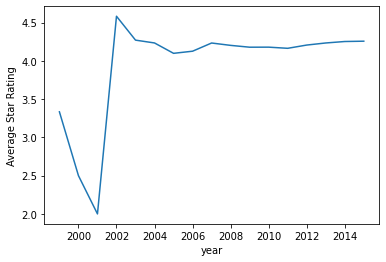

In [ ]:
from pyspark.sql.functions import year, avg, to_date
import matplotlib.pyplot as plt

# Tạo Spark Session
spark = SparkSession.builder.appName("MyApp").getOrCreate()

# Đọc dữ liệu từ tệp TSV trên Hadoop và chuyển đổi sang định dạng DataFrame của Spark
df_shoes = spark.read.format("csv").option("header", True).option("delimiter", "\t").load("hdfs://localhost:9000/amazon_reviews_us_Shoes_v1_00.tsv")

# Chuyển đổi cột review_date sang định dạng datetime và lấy tháng
df_shoes = df_shoes.withColumn("review_date", to_date("review_date", "yyyy-MM-dd")).withColumn("year", year("review_date"))

# Nhóm dữ liệu theo tháng và tính trung bình của star_rating trong mỗi nhóm
df_monthly = df_shoes.groupBy("year").agg(avg("star_rating").alias("avg_rating")).orderBy("year")

# Chuyển đổi định dạng DataFrame của Spark sang pandas để vẽ biểu đồ
df_monthly_pd = df_monthly.toPandas()

# Vẽ biểu đồ đường
plt.plot(df_monthly_pd['year'], df_monthly_pd['avg_rating'])
plt.xlabel('year')
plt.ylabel('Average Star Rating')
plt.show()


In [ ]:
from pyspark.sql.functions import col
filtered_df = df.filter(col("star_rating") <= 3)
count_filtered_df = filtered_df.count()
print("Number of rows :", count_filtered_df)
small_df = filtered_df.filter((col("review_body").like("%small%")) | (col("review_headline").like("%small%")))
count_small = small_df.count()
print("Number of rows containing 'small':", count_small)
small_ratio = count_small / count_filtered_df
print("Small ratio: {:.2%}".format(small_ratio))
# Loại bỏ các cột đó khỏi DataFrame
filtered_df = filtered_df.subtract(small_df)

# Hiển thị DataFrame mới
filtered_df.select("review_body").show(5000, False)


NameError: name 'df' is not defined

In [ ]:
from pyspark.sql.functions import col

# Chuyển đổi kiểu dữ liệu cột star_rating sang kiểu số nguyên
df = df.withColumn("star_rating", col("star_rating").cast("int"))

# Sử dụng groupBy(), avg() và count() để tính trung bình cộng của star_rating và số lượng đánh giá cho mỗi product_id
result = df.groupBy("product_id").agg({"star_rating": "avg", "*": "count"}).withColumnRenamed("avg(star_rating)", "avg_star_rating").withColumnRenamed("count(1)", "num_reviews")

# Sắp xếp kết quả theo thứ tự tăng dần của trung bình cộng của star_rating
result = result.orderBy("avg_star_rating", ascending=True)

result.show(200)


+----------+---------------+-----------+
|product_id|avg_star_rating|num_reviews|
+----------+---------------+-----------+
|B00JBAUD5C|            1.0|          1|
|B00EI468C8|            1.0|          1|
|B00FYMNF5Q|            1.0|          1|
|B00HF77X1U|            1.0|          1|
|B00RLL88UU|            1.0|          1|
|B00NVIQI40|            1.0|          1|
|B00F3Q7428|            1.0|          1|
|B00PTJTX3C|            1.0|          1|
|B012BH4EBU|            1.0|          1|
|B00UN33PVA|            1.0|          1|
|B009AGPVFO|            1.0|          1|
|B00IHTBZ5A|            1.0|          1|
|B00HS3G1UK|            1.0|          1|
|B00MQB57P4|            1.0|          1|
|B00RNFTKGK|            1.0|          1|
|B00OCKUOBY|            1.0|          1|
|B00PXMQ9AK|            1.0|          1|
|B00DQYP5C0|            1.0|          1|
|B002GODRGW|            1.0|          1|
|B00DOO8UMO|            1.0|          1|
|B002KAOD10|            1.0|          1|
|B00DV842HU|    

In [ ]:
from pyspark.sql.functions import col

# Chuyển đổi kiểu dữ liệu cột star_rating sang kiểu số nguyên
df = df.withColumn("star_rating", col("star_rating").cast("int"))

# Sử dụng groupBy(), avg() và count() để tính trung bình cộng của star_rating và số lượng đánh giá cho mỗi product_parent
result = df.groupBy("product_parent").agg({"star_rating": "avg", "*": "count"}).withColumnRenamed("avg(star_rating)", "avg_star_rating").withColumnRenamed("count(1)", "num_reviews")

# Sắp xếp kết quả theo thứ tự tăng dần của trung bình cộng của star_rating
result = result.orderBy("avg_star_rating", ascending=True)

result.show(200)


+--------------+---------------+-----------+
|product_parent|avg_star_rating|num_reviews|
+--------------+---------------+-----------+
|     803717069|            1.0|          1|
|     830774735|            1.0|          3|
|     469132425|            1.0|          1|
|      69849165|            1.0|          1|
|     126025684|            1.0|          1|
|     411506598|            1.0|          1|
|     817845280|            1.0|          1|
|     321477824|            1.0|          1|
|      79244890|            1.0|          1|
|     960595232|            1.0|          1|
|     813820363|            1.0|          1|
|     414337545|            1.0|          1|
|     874809814|            1.0|          1|
|      41842984|            1.0|          1|
|     980355285|            1.0|          1|
|     702881301|            1.0|          1|
|     571929958|            1.0|          1|
|     613359660|            1.0|          1|
|     286975020|            1.0|          1|
|     4585